In [ ]:
# IMPORTANT: RUN THIS CELL IN ORDER TO IMPORT YOUR KAGGLE DATA SOURCES,
# THEN FEEL FREE TO DELETE THIS CELL.
# NOTE: THIS NOTEBOOK ENVIRONMENT DIFFERS FROM KAGGLE'S PYTHON
# ENVIRONMENT SO THERE MAY BE MISSING LIBRARIES USED BY YOUR
# NOTEBOOK.
import kagglehub
prasoonkottarathil_face_mask_lite_dataset_path = kagglehub.dataset_download('prasoonkottarathil/face-mask-lite-dataset')

print('Data source import complete.')


Resuming download from 65011712 bytes (24937238223 bytes left)...
Resuming download from https://www.kaggle.com/api/v1/datasets/download/prasoonkottarathil/face-mask-lite-dataset?dataset_version_number=1 (65011712/25002249935) bytes left.


100%|██████████| 23.3G/23.3G [17:26<00:00, 23.8MB/s]

Extracting files...


Data source import complete.


# Introduction
<img src = 'https://cdn-images-1.medium.com/max/900/1*TKr1dtcNgJCA8uYY1OhmSg.png'>

Generative Adversarial Networks (GANs) are generative models. They are uses unsupervised technique to generate new things. GAN models learns pattern in input data in such a way that they can generate new sample which resemble with the input data. The main aim of generative adversarial network is to match generated distribution with the original data distribution.

GANs are an exciting and rapidly changing field, delivering generative models ability to generate realistic examples across a range of problem domains, most notably in image-to-image translation tasks such as translating photos of summer to winter or day to night,coloring images and in generating fake photos that even human cannot categorized as fake image.
This <a href = 'https://thispersondoesnotexist.com/'> site </a> uses GAN to generate fake human faces which are similar to real human

### Components of GANs
<b> Generator </b>: Generator are neural network that learns to generate data which resemble with the input distribution. The generator model take fixed dimension random vector from Gaussian distribution as input and generate the sample out of it which resemble with input.

<b> Discriminator </b>: Discriminator are simple neural network that distinguish fake and real data.The discriminator model takes an example from the domain as input (real or generated) and predicts a binary class label of real or fake.

Generative adversarial networks are based on a game theoretic scenario in which the generator network must compete against an adversary. The generator network directly produces samples. Its adversary, the discriminator network, attempts to distinguish between samples drawn from the training data and samples drawn from the generator.

# Working of GANs
<img src = 'https://cdn.analyticsvidhya.com/wp-content/uploads/2017/06/11000153/g1.jpg'>

First of all we take batch of random vector from the Gaussian distribution and generate fake image out of it using generator. Since generator isn't trained so generated image donot resemble with the real input distribution. We take batches of image from the input distribution along with generated fake images and fed it to discriminator so that it learns to distinguish between real and fake images.
Now, after training discriminator, we take the batch of images that generator generated and fed them through discriminator again (here we donot fed real images), discriminator will provide an output probabilities, these values are then compared with the probability that the generator should generated (ie 1), error is calculated and backpropagated through the generator and the weight are updated.
This above process is repeated until generated images resemble with the input distribution.

## Objective: To generate fake faces of human

## Import necessary Libraries

In [ ]:
import tensorflow as tf
import keras
from keras import layers
import numpy as np
import matplotlib.pyplot as plt
import cv2
import os
from tqdm import tqdm
import re
from keras.preprocessing.image import img_to_array

## Load data
Here I have used face-mask-lite-dataset, out of available 10000 images i have only use 9090 image. I have read image using opencv since opencv reads image in bgr format i have converted it back to rgb format using cvtColor function. These images are resize into 128 by 128 using resize function and are finally converted to array and are appended in empty array

In [ ]:
# to get the files in proper order
def sorted_alphanumeric(data):
    convert = lambda text: int(text) if text.isdigit() else text.lower()
    alphanum_key = lambda key: [convert(c) for c in re.split('([0-9]+)',key)]
    return sorted(data,key = alphanum_key)
# defining the size of the image
SIZE = 128
_img = []
path = os.path.join(prasoonkottarathil_face_mask_lite_dataset_path, 'without_mask')
files = os.listdir(path)
files = sorted_alphanumeric(files)
for i in tqdm(files):
        if i == 'seed9090.png':
            break
        else:
            img = cv2.imread(path + '/'+i,1)
            # open cv reads images in BGR format so we have to convert it to RGB
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            #resizing image
            img = cv2.resize(img, (SIZE, SIZE))
            img = (img - 127.5) / 127.5
            imh = img.astype(float)
            _img.append(img_to_array(img))

 91%|█████████ | 9090/10000 [06:39<00:40, 22.73it/s]


## Visualize our images

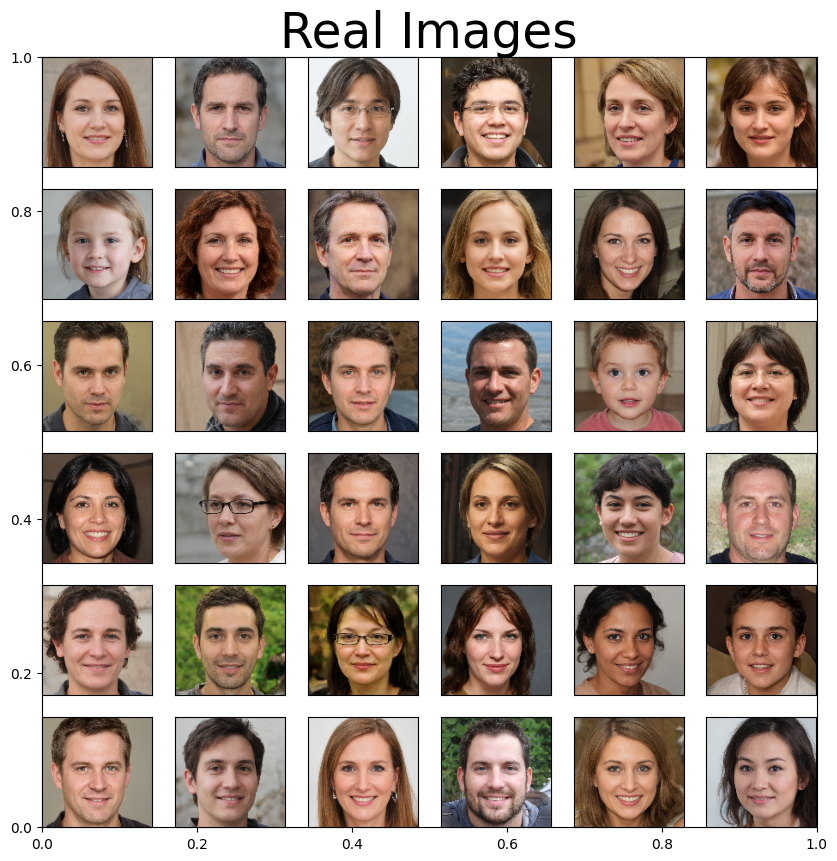

In [ ]:
def plot_images(sqr = 5):
    plt.figure(figsize = (10,10))
    plt.title("Real Images",fontsize = 35)
    for i in range(sqr * sqr):
        plt.subplot(sqr,sqr,i+1)
        plt.imshow(_img[i]*0.5 + 0.5 )
        plt.xticks([])
        plt.yticks([])

# to plot images
plot_images(6)


Here, i have defined batch size so that these batches of images can be fed directly to the discriminator network

In [ ]:
batch_size = 32
dataset=tf.data.Dataset.from_tensor_slices(np.array(_img)).batch(batch_size)

# Generator
Here, I have defined generator network. It take random vector from normal distribution as input. This random vector is passed through dense layer and is reshaped and is finally fed through Convolution layers. Here, convolution layers does downsampling of our latent vector, after series of convolution batch normalization and leakyrelu layer our downsampled latent vector is upsampled using Conv2DTranspose.

The final output layer of Generator generate 128 by 128 by 3 image. The final layer of generator uses hyperbolic tangent as activation to squash the value in between -1 and 1. Generator model looks like simple autoencoder model, where input data is downsampled first and is finally upsampled .

In [ ]:
latent_dim = 100
def Generator():
    model = tf.keras.Sequential()
    model.add(layers.Dense(128*128*3, use_bias=False, input_shape=(latent_dim,)))
    model.add(layers.Reshape((128,128,3)))
    # downsampling
    model.add(tf.keras.layers.Conv2D(128,4, strides=1, padding='same',kernel_initializer='he_normal', use_bias=False))
    model.add(tf.keras.layers.Conv2D(128,4, strides=2, padding='same',kernel_initializer='he_normal', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Conv2D(256,4, strides=1, padding='same',kernel_initializer='he_normal', use_bias=False))
    model.add(tf.keras.layers.Conv2D(256,4, strides=2, padding='same',kernel_initializer='he_normal', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Conv2DTranspose(512, 4, strides=1,padding='same',kernel_initializer='he_normal',use_bias=False))
    model.add(tf.keras.layers.Conv2D(512,4, strides=2, padding='same',kernel_initializer='he_normal', use_bias=False))

    model.add(tf.keras.layers.LeakyReLU())
    #upsampling
    model.add(tf.keras.layers.Conv2DTranspose(512, 4, strides=1,padding='same',kernel_initializer='he_normal',use_bias=False))
    model.add(tf.keras.layers.Conv2DTranspose(512, 4, strides=2,padding='same',kernel_initializer='he_normal',use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Conv2DTranspose(256, 4, strides=1,padding='same',kernel_initializer='he_normal',use_bias=False))
    model.add(tf.keras.layers.Conv2DTranspose(256, 4, strides=2,padding='same',kernel_initializer='he_normal',use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())

    model.add(tf.keras.layers.Conv2DTranspose(128, 4, strides=2,padding='same',kernel_initializer='he_normal',use_bias=False))
    model.add(tf.keras.layers.Conv2DTranspose(128, 4, strides=1,padding='same',kernel_initializer='he_normal',use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.Conv2DTranspose(3,4,strides = 1, padding = 'same',activation = 'tanh'))



    return model

In [ ]:
generator = Generator()
generator.summary()

/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense (Dense)                        │ (None, 49152)               │       4,915,200 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ reshape (Reshape)                    │ (None, 128, 128, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d (Conv2D)                      │ (None, 128, 128, 128)       │           6,144 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_1 (Conv2D)                    │ (None, 64, 64, 128)         │         262,144 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization                  │ (None, 64, 64, 128)         │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu (LeakyReLU)              │ (None, 64, 64, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_2 (Conv2D)                    │ (None, 64, 64, 256)         │         524,288 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_3 (Conv2D)                    │ (None, 32, 32, 256)         │       1,048,576 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_1                │ (None, 32, 32, 256)         │           1,024 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_1 (LeakyReLU)            │ (None, 32, 32, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose (Conv2DTranspose)   │ (None, 32, 32, 512)         │       2,097,152 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_4 (Conv2D)                    │ (None, 16, 16, 512)         │       4,194,304 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_2 (LeakyReLU)            │ (None, 16, 16, 512)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_1 (Conv2DTranspose) │ (None, 16, 16, 512)         │       4,194,304 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_2 (Conv2DTranspose) │ (None, 32, 32, 512)         │       4,194,304 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_2                │ (None, 32, 32, 512)         │           2,048 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_3 (LeakyReLU)            │ (None, 32, 32, 512)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_3 (Conv2DTranspose) │ (None, 32, 32, 256)         │       2,097,152 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_4 (Conv2DTranspose) │ (None, 64, 64, 256)         │       1,048,576 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_3                │ (None, 64, 64, 256)         │           1,0

 Total params: 25,379,843 (96.82 MB)

 Trainable params: 25,377,283 (96.81 MB)

 Non-trainable params: 2,560 (10.00 KB)

# Discriminator
Here, discriminator model take 128 by 128 by 3 image that can be real or generated. This input image is downsampled using Convolution layer and is finally flattened and is fed to single neuron so that it can distinguish real and fake image. Since, final layer uses sigmoid function as activation, it output value in between 0 and 1. Here value greater than 0.5 refers to real and less than 0.5 refers to fake image. The output of discriminator is used in training of generator.

In [ ]:
def Discriminator():
    model = tf.keras.models.Sequential()
    model.add(tf.keras.layers.Input((SIZE, SIZE, 3)))
    model.add(tf.keras.layers.Conv2D(128,4, strides=2, padding='same',kernel_initializer='he_normal', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Conv2D(128,4, strides=2, padding='same',kernel_initializer='he_normal', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Conv2D(256,4, strides=2, padding='same',kernel_initializer='he_normal', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Conv2D(256,4, strides=2, padding='same',kernel_initializer='he_normal', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Conv2D(512,4, strides=2, padding='same',kernel_initializer='he_normal', use_bias=False))
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Flatten())
    model.add(tf.keras.layers.Dense(1,activation = 'sigmoid'))
    return model



In [ ]:
discriminator = Discriminator()
discriminator.summary()

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_5 (Conv2D)                    │ (None, 64, 64, 128)         │           6,144 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_5                │ (None, 64, 64, 128)         │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_4 (LeakyReLU)            │ (None, 64, 64, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_6 (Conv2D)                    │ (None, 32, 32, 128)         │         262,144 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_6                │ (None, 32, 32, 128)         │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_5 (LeakyReLU)            │ (None, 32, 32, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_7 (Conv2D)                    │ (None, 16, 16, 256)         │         524,288 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_7                │ (None, 16, 16, 256)         │           1,024 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_6 (LeakyReLU)            │ (None, 16, 16, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_8 (Conv2D)                    │ (None, 8, 8, 256)           │       1,048,576 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_8                │ (None, 8, 8, 256)           │           1,024 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_7 (LeakyReLU)            │ (None, 8, 8, 256)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_9 (Conv2D)                    │ (None, 4, 4, 512)           │       2,097,152 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_8 (LeakyReLU)            │ (None, 4, 4, 512)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 8192)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 1)                   │           8,193 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 3,949,569 (15.07 MB)

 Trainable params: 3,948,033 (15.06 MB)

 Non-trainable params: 1,536 (6.00 KB)

### Let's plot image generated by generator before training

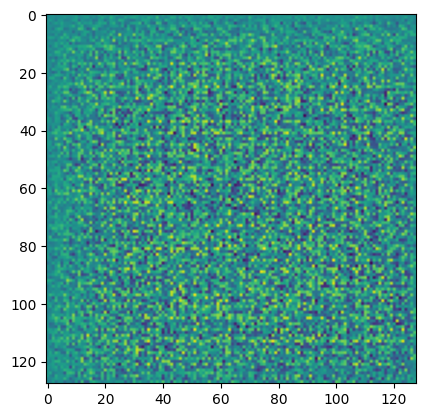

In [ ]:
noise = np.random.normal(-1,1,(1,100))
img = generator(noise)
plt.imshow(img[0,:,:,0])
plt.show()

### Defining loss function and optimizer

In [ ]:
# Define separate optimizers
generator_optimizer = tf.keras.optimizers.RMSprop(
    learning_rate=0.0001,
    clipvalue=1.0,
    decay=1e-8
)
discriminator_optimizer = tf.keras.optimizers.RMSprop(
    learning_rate=0.0001,
    clipvalue=1.0,
    decay=1e-8
)

/usr/local/lib/python3.11/dist-packages/keras/src/optimizers/base_optimizer.py:86: UserWarning: Argument `decay` is no longer supported and will be ignored.
  warnings.warn(


In [ ]:
# Define your loss
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

def discriminator_loss(fake_output, real_output):
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    return fake_loss + real_loss


### Defining training steps

In [ ]:
# Training step
#tf.GradientTape() is a TensorFlow utility used for automatic differentiation.
#It records operations on tensors during the forward pass and allows us to compute gradients of these operations with respect to model parameters during backpropagation.

#gen_tape → Tracks operations related to the generator (gen_tape does not track the discriminator’s parameters—only the generator's.)
#disc_tape → Tracks operations related to the discriminator.

@tf.function
def train_steps(images):
    noise = tf.random.normal([batch_size, latent_dim])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        generated_images = generator(noise, training=True)

        fake_output = discriminator(generated_images, training=True)
        real_output = discriminator(images, training=True)

        gen_loss = generator_loss(fake_output)
        disc_loss = discriminator_loss(fake_output, real_output)

    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    # Apply gradients using correct optimizers
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))
    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))

    loss = {
        'gen_loss': gen_loss,
        'disc_loss': disc_loss
    }

    return loss


## function to plot generated images


In [ ]:
def generate_and_save_images(generator, epoch, fixed_noise):
    """Generates and saves images from the TensorFlow generator."""
    predictions = generator(fixed_noise, training=False)  # Generate fake images

    fig, ax = plt.subplots(1, 5, figsize=(10, 2))  # Display 5 sample images
    for i in range(5):
        img = predictions[i, :, :, 0] if predictions.shape[-1] == 1 else predictions[i]  # Handle grayscale/RGB
        ax[i].imshow((img * 127.5 + 127.5).numpy().astype(np.uint8))  # Normalize to [0,255]
        ax[i].axis("off")

    plt.savefig(f"generated_images_epoch_{epoch}.png")  # Save image
    plt.show()

In [ ]:
def plot_generated_images(square = 5, epochs = 0):


  plt.figure(figsize = (10,10))
  for i in range(square * square):
    if epochs != 0:
        if(i == square //2):
            plt.title("Generated Image at Epoch:{}\n".format(epochs), fontsize = 32, color = 'black')
    plt.subplot(square, square, i+1)
    noise = np.random.normal(0,1,(1,latent_dim))
    img = generator(noise)
    plt.imshow(np.clip((img[0,...]+1)/2, 0, 1))

    plt.xticks([])
    plt.yticks([])
    plt.grid()

Epoch : 1
 Time:25.06
Generator Loss: 25.882104873657227 Discriminator Loss: 6.662057190631732e-12


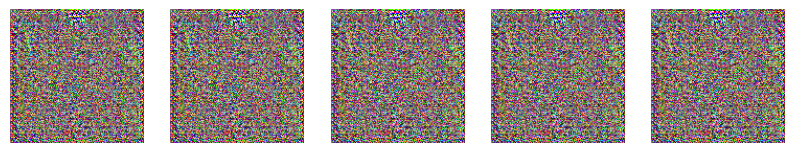

Epoch : 2
 Time:25.06
Generator Loss: 0.00018981474568136036 Discriminator Loss: 8.717794418334961


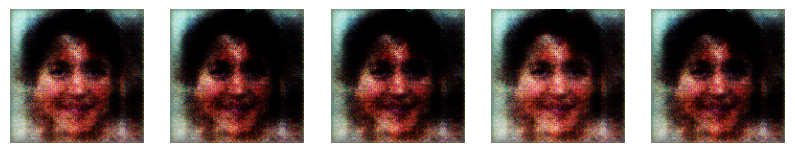

Epoch : 3
 Time:25.09
Generator Loss: 0.1946442723274231 Discriminator Loss: 1.7452001571655273


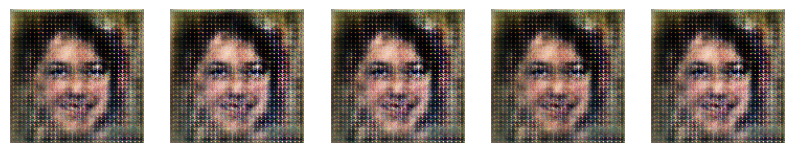

Epoch : 4
 Time:25.12
Generator Loss: 8.741449356079102 Discriminator Loss: 2.109731912612915


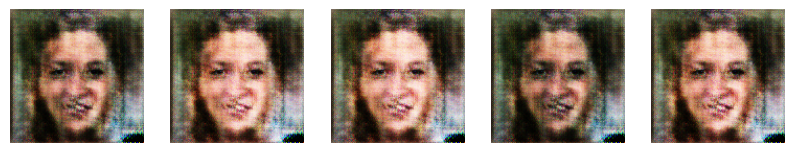

Epoch : 5
 Time:25.14
Generator Loss: 3.3427393436431885 Discriminator Loss: 2.3540496826171875


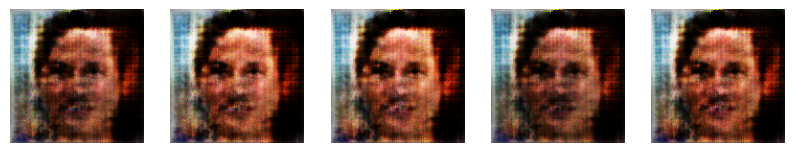

Epoch : 6
 Time:25.13
Generator Loss: 15.089527130126953 Discriminator Loss: 2.320674419403076


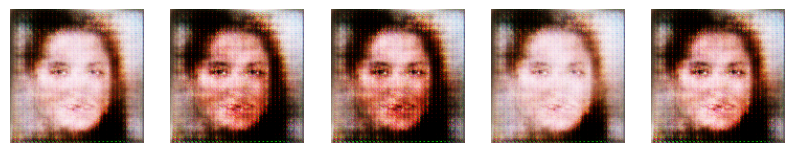

Epoch : 7
 Time:25.11
Generator Loss: 0.1315111219882965 Discriminator Loss: 2.2539162635803223


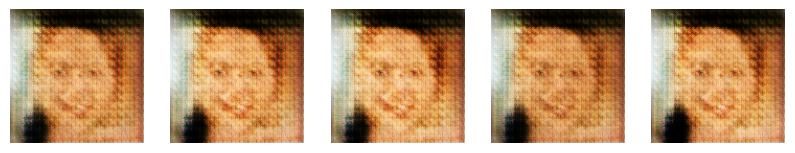

Epoch : 8
 Time:25.14
Generator Loss: 1.0992200374603271 Discriminator Loss: 0.4322487413883209


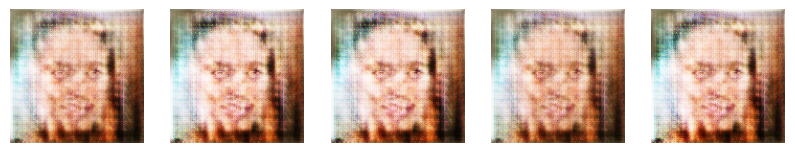

Epoch : 9
 Time:25.15
Generator Loss: 12.740608215332031 Discriminator Loss: 0.0002853163459803909


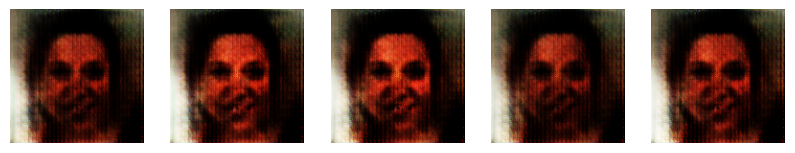

Epoch : 10
 Time:25.16
Generator Loss: 0.17618326842784882 Discriminator Loss: 2.331744432449341


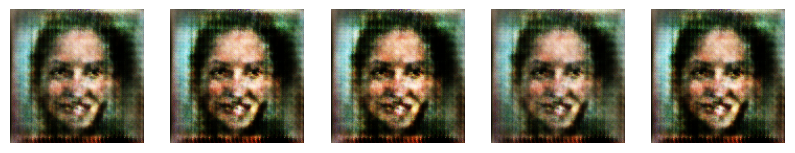

Epoch : 11
 Time:25.15
Generator Loss: 11.265275955200195 Discriminator Loss: 3.03602933883667


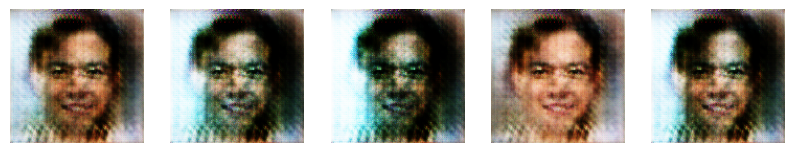

Epoch : 12
 Time:25.14
Generator Loss: 1.5092048645019531 Discriminator Loss: 0.48852717876434326


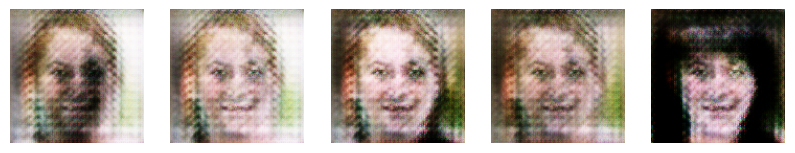

Epoch : 13
 Time:25.16
Generator Loss: 1.9340368509292603 Discriminator Loss: 0.7759906649589539


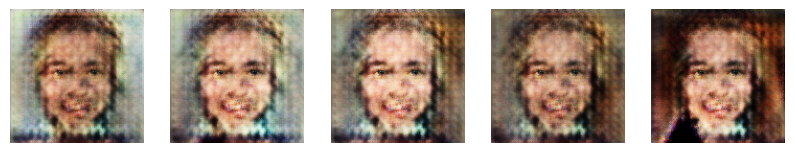

Epoch : 14
 Time:25.15
Generator Loss: 1.5313481092453003 Discriminator Loss: 0.5316290855407715


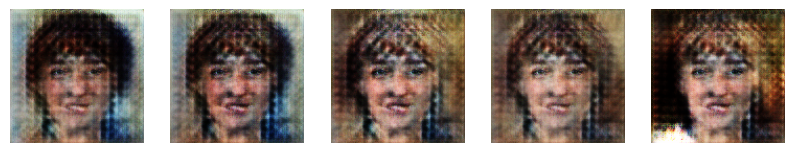

Epoch : 15
 Time:25.15
Generator Loss: 0.3980160355567932 Discriminator Loss: 2.801492929458618


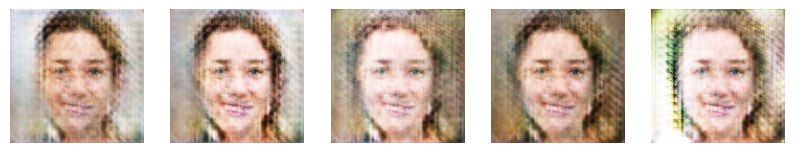

Epoch : 16
 Time:25.15
Generator Loss: 1.0359781980514526 Discriminator Loss: 1.807171106338501


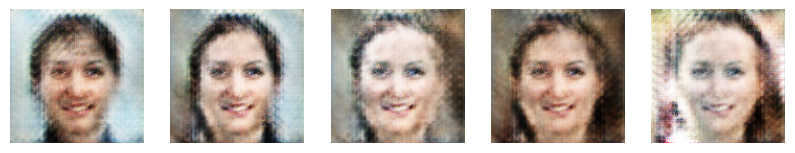

Epoch : 17
 Time:25.15
Generator Loss: 6.688552379608154 Discriminator Loss: 1.4086267948150635


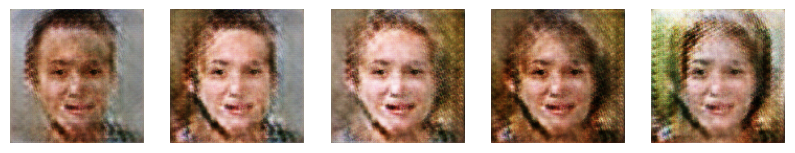

Epoch : 18
 Time:25.15
Generator Loss: 2.609598159790039 Discriminator Loss: 1.0648818016052246


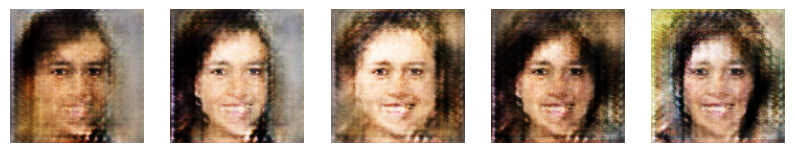

Epoch : 19
 Time:25.13
Generator Loss: 2.6667611598968506 Discriminator Loss: 0.7977757453918457


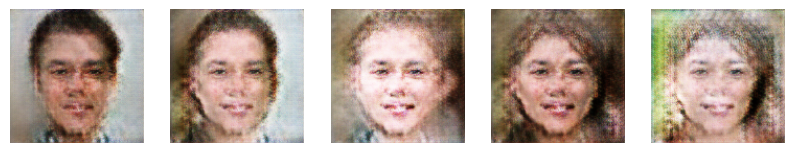

Epoch : 20
 Time:25.12
Generator Loss: 5.9628729820251465 Discriminator Loss: 1.458458662033081


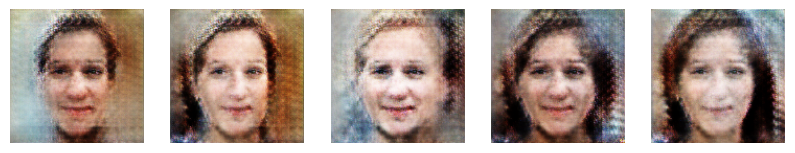

Epoch : 21
 Time:25.12
Generator Loss: 3.4884753227233887 Discriminator Loss: 0.23380997776985168


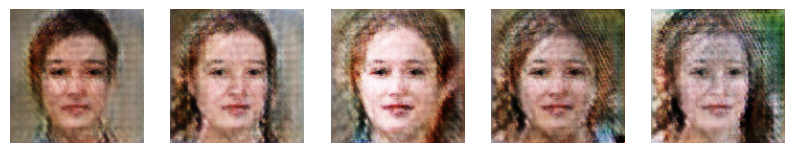

Epoch : 22
 Time:25.11
Generator Loss: 0.46447300910949707 Discriminator Loss: 1.7656159400939941


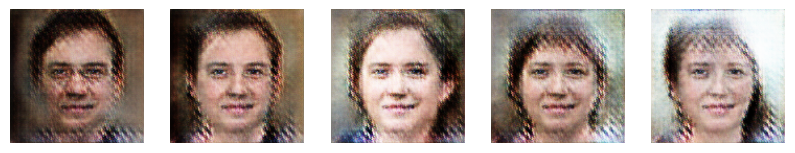

Epoch : 23
 Time:25.11
Generator Loss: 1.7013810873031616 Discriminator Loss: 0.46428993344306946


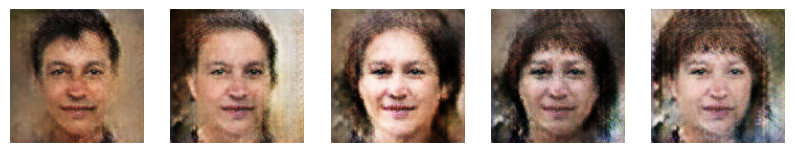

Epoch : 24
 Time:25.15
Generator Loss: 1.1985504627227783 Discriminator Loss: 0.6998231410980225


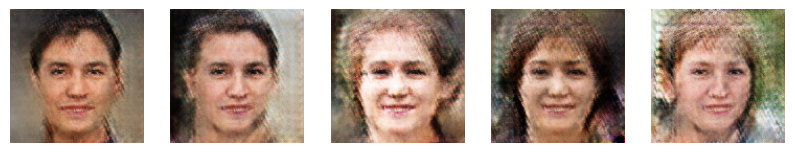

Epoch : 25
 Time:25.16
Generator Loss: 0.8312571048736572 Discriminator Loss: 2.131991147994995


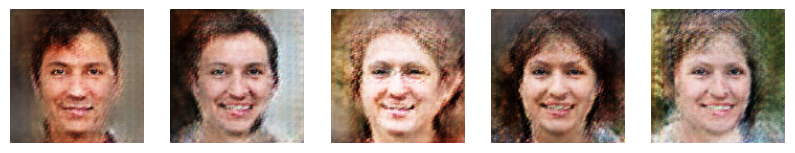

Epoch : 26
 Time:25.15
Generator Loss: 4.55555534362793 Discriminator Loss: 3.233621120452881


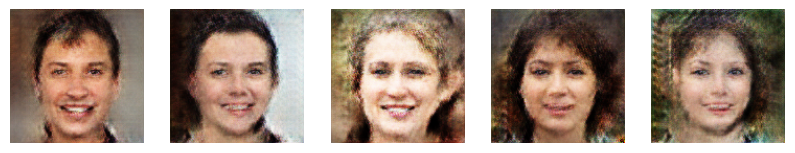

Epoch : 27
 Time:25.16
Generator Loss: 2.125936508178711 Discriminator Loss: 0.35491517186164856


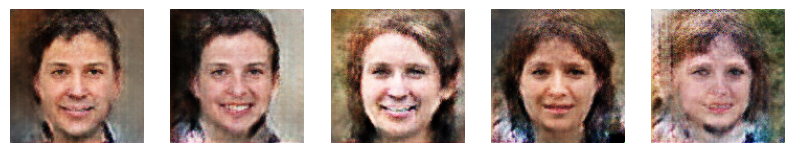

Epoch : 28
 Time:25.16
Generator Loss: 2.256248950958252 Discriminator Loss: 0.981080949306488


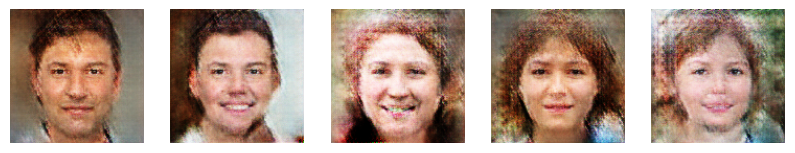

Epoch : 29
 Time:25.16
Generator Loss: 2.6612277030944824 Discriminator Loss: 2.012927293777466


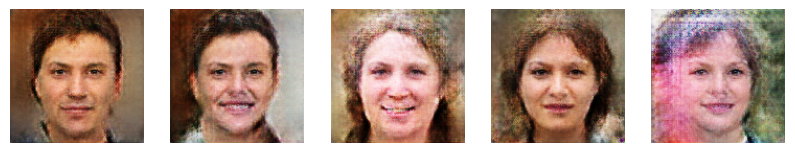

Epoch : 30
 Time:25.14
Generator Loss: 2.891953229904175 Discriminator Loss: 0.8309128880500793


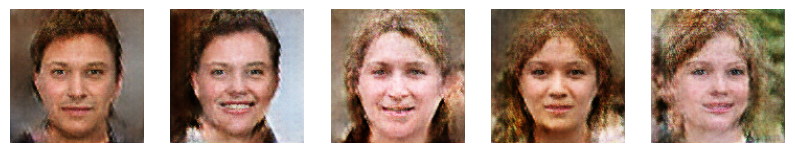

Epoch : 31
 Time:25.14
Generator Loss: 0.676467776298523 Discriminator Loss: 1.1003482341766357


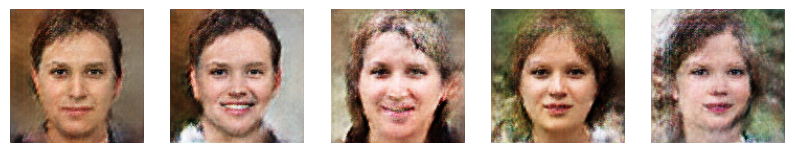

Epoch : 32
 Time:25.16
Generator Loss: 0.7612824440002441 Discriminator Loss: 0.953272819519043


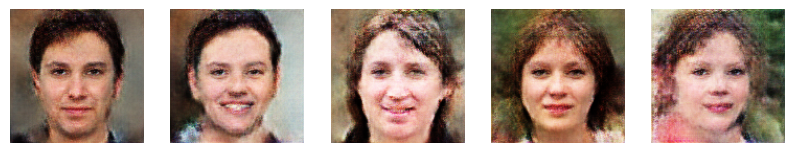

Epoch : 33
 Time:25.16
Generator Loss: 0.2852391004562378 Discriminator Loss: 1.6642557382583618


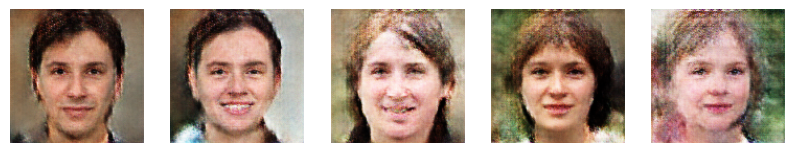

Epoch : 34
 Time:25.16
Generator Loss: 3.8165981769561768 Discriminator Loss: 0.8494415283203125


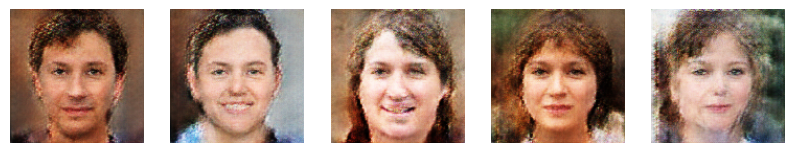

Epoch : 35
 Time:25.15
Generator Loss: 2.0544919967651367 Discriminator Loss: 0.31657516956329346


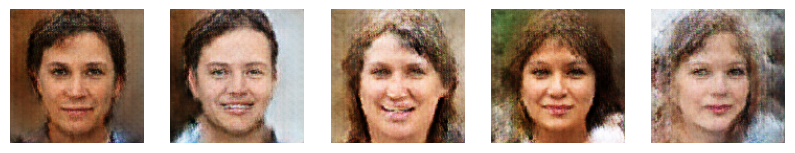

Epoch : 36
 Time:25.15
Generator Loss: 1.1511824131011963 Discriminator Loss: 0.6037120819091797


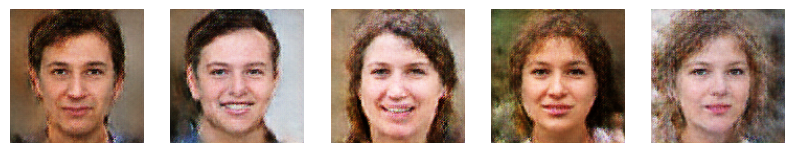

Epoch : 37
 Time:25.15
Generator Loss: 2.942110300064087 Discriminator Loss: 0.35149943828582764


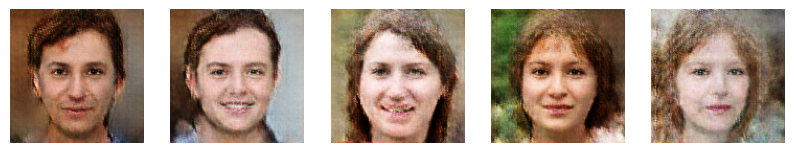

Epoch : 38
 Time:25.15
Generator Loss: 0.4534781873226166 Discriminator Loss: 1.4512429237365723


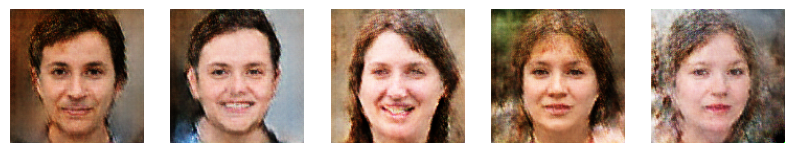

Epoch : 39
 Time:25.14
Generator Loss: 2.670370578765869 Discriminator Loss: 0.1913323849439621


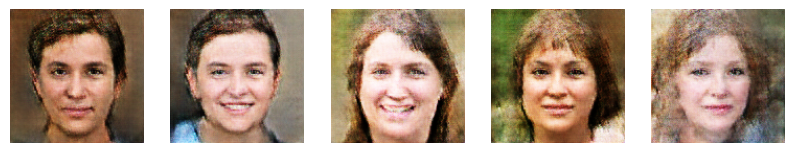

Epoch : 40
 Time:25.11
Generator Loss: 2.057957172393799 Discriminator Loss: 0.43230903148651123


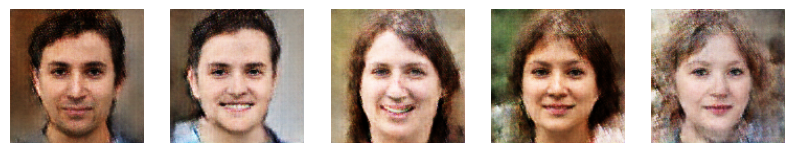

Epoch : 41
 Time:25.1
Generator Loss: 1.1238188743591309 Discriminator Loss: 0.5696807503700256


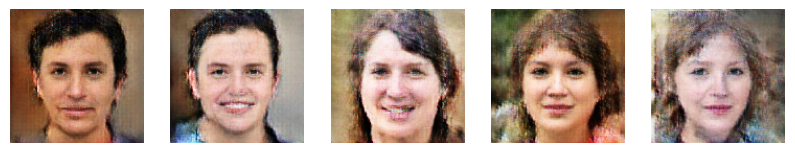

Epoch : 42
 Time:25.11
Generator Loss: 0.9717642068862915 Discriminator Loss: 0.705161452293396


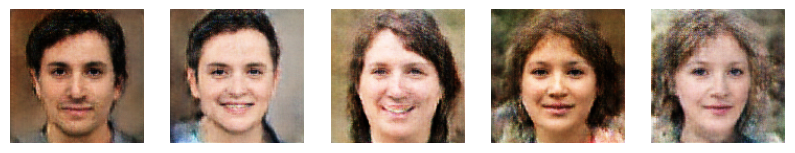

Epoch : 43
 Time:25.12
Generator Loss: 3.9564735889434814 Discriminator Loss: 0.7618123292922974


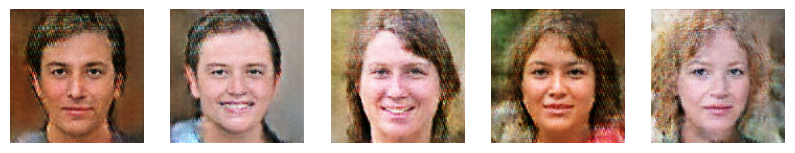

Epoch : 44
 Time:25.13
Generator Loss: 2.331094264984131 Discriminator Loss: 0.2702808380126953


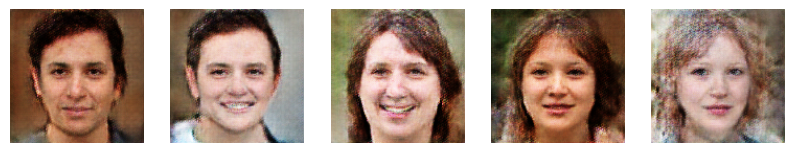

Epoch : 45
 Time:25.14
Generator Loss: 1.3230341672897339 Discriminator Loss: 0.4762440025806427


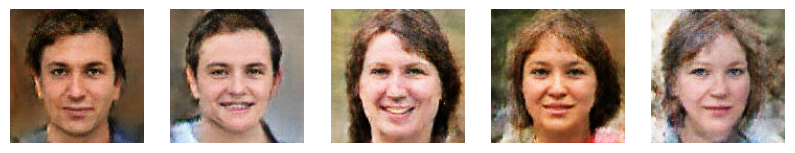

Epoch : 46
 Time:25.12
Generator Loss: 0.6696990728378296 Discriminator Loss: 1.1441636085510254


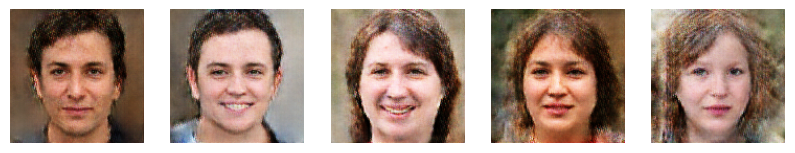

Epoch : 47
 Time:25.15
Generator Loss: 2.1981639862060547 Discriminator Loss: 0.3496292233467102


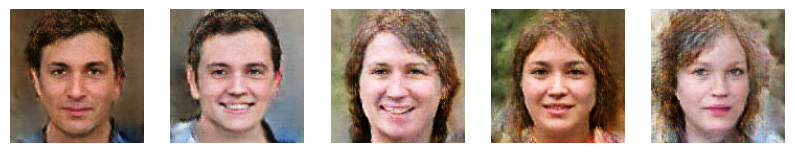

Epoch : 48
 Time:25.15
Generator Loss: 0.3118714392185211 Discriminator Loss: 1.7007683515548706


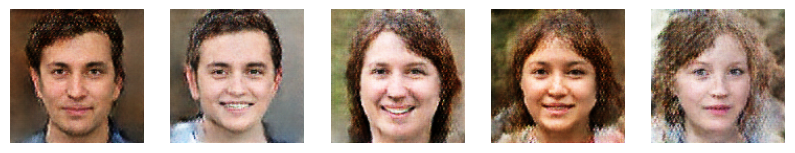

Epoch : 49
 Time:25.16
Generator Loss: 3.541506290435791 Discriminator Loss: 0.5514988303184509


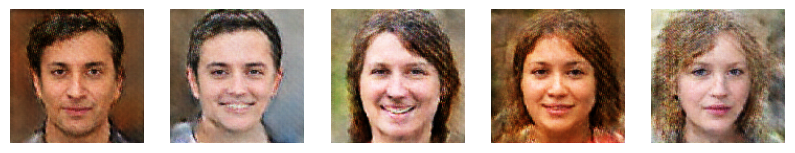

Epoch : 50
 Time:25.16
Generator Loss: 3.789827823638916 Discriminator Loss: 0.10508942604064941


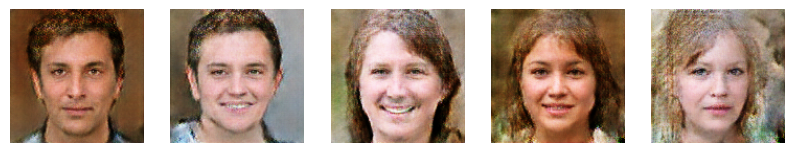

Epoch : 51
 Time:25.14
Generator Loss: 1.3455774784088135 Discriminator Loss: 0.5302140712738037


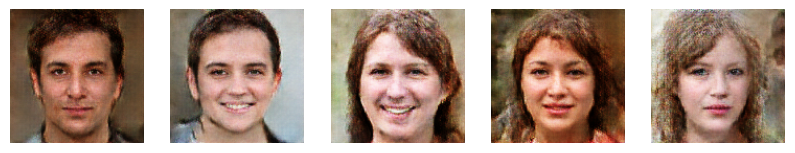

Epoch : 52
 Time:25.15
Generator Loss: 1.4217567443847656 Discriminator Loss: 0.4539299011230469


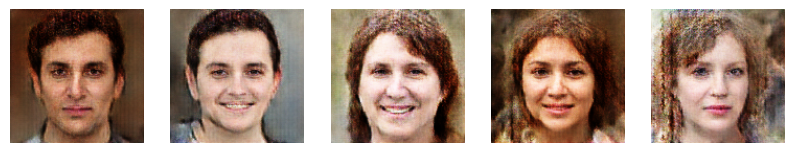

Epoch : 53
 Time:25.17
Generator Loss: 2.008911609649658 Discriminator Loss: 0.25069352984428406


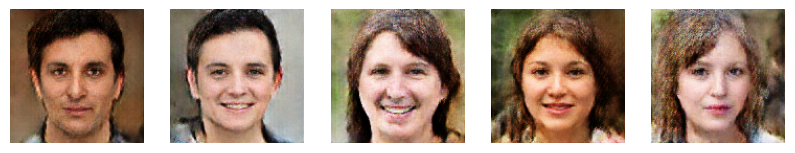

Epoch : 54
 Time:25.16
Generator Loss: 1.6406769752502441 Discriminator Loss: 0.5146903395652771


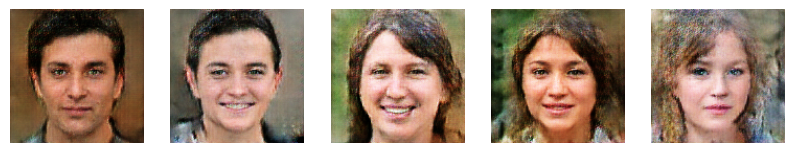

Epoch : 55
 Time:25.15
Generator Loss: 1.6957576274871826 Discriminator Loss: 0.42040351033210754


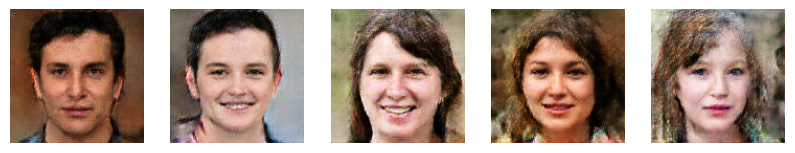

Epoch : 56
 Time:25.11
Generator Loss: 4.04628324508667 Discriminator Loss: 0.3381902873516083


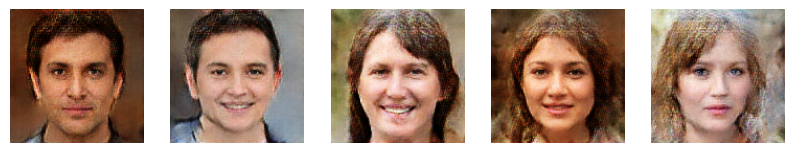

Epoch : 57
 Time:25.15
Generator Loss: 2.9663400650024414 Discriminator Loss: 0.16326604783535004


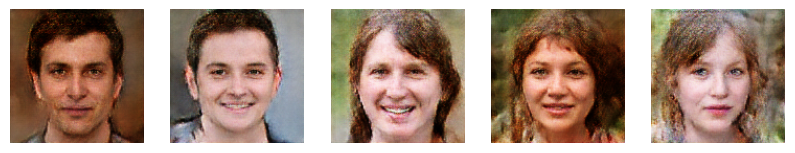

Epoch : 58
 Time:25.15
Generator Loss: 1.5578992366790771 Discriminator Loss: 0.4676225185394287


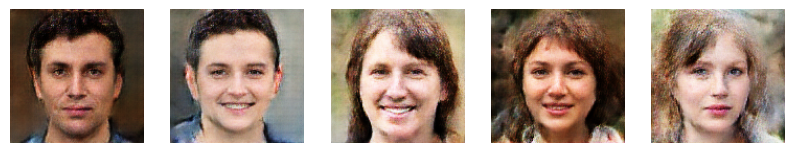

Epoch : 59
 Time:25.16
Generator Loss: 3.8106558322906494 Discriminator Loss: 0.05775982514023781


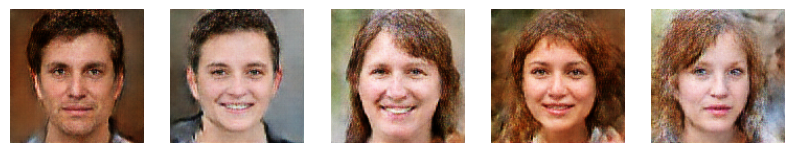

Epoch : 60
 Time:25.16
Generator Loss: 1.855280876159668 Discriminator Loss: 0.3920847773551941


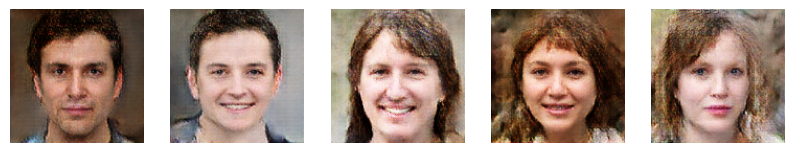

Epoch : 61
 Time:25.16
Generator Loss: 0.3409864604473114 Discriminator Loss: 2.0685818195343018


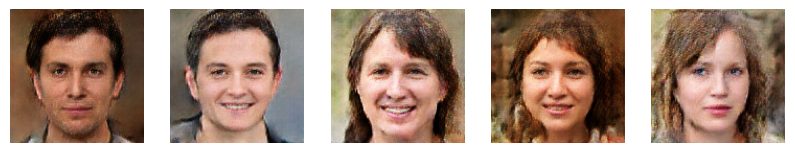

Epoch : 62
 Time:25.15
Generator Loss: 1.8515205383300781 Discriminator Loss: 0.33477455377578735


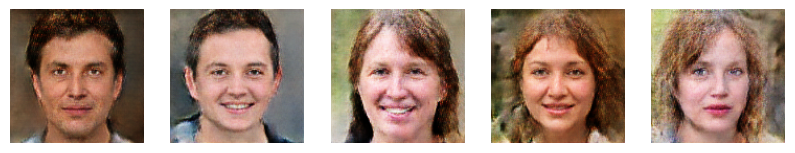

Epoch : 63
 Time:25.14
Generator Loss: 1.3603794574737549 Discriminator Loss: 0.6781019568443298


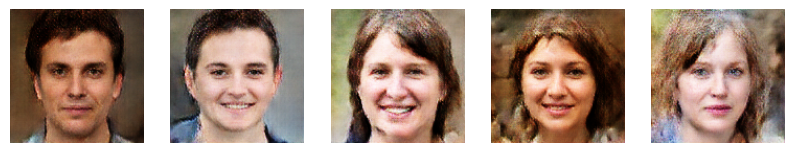

Epoch : 64
 Time:25.15
Generator Loss: 2.8741493225097656 Discriminator Loss: 0.21266278624534607


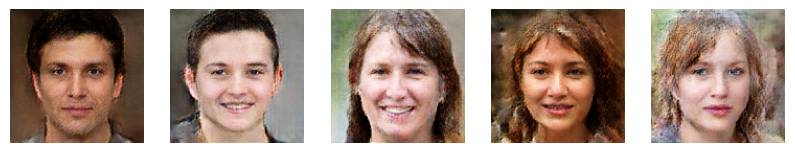

Epoch : 65
 Time:25.16
Generator Loss: 0.8818253874778748 Discriminator Loss: 0.7369747757911682


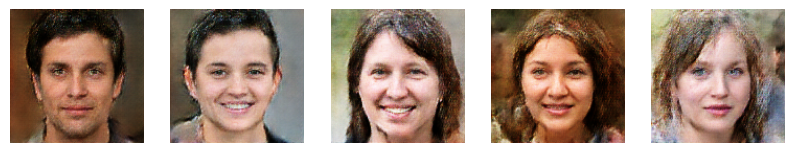

Epoch : 66
 Time:25.17
Generator Loss: 2.2299399375915527 Discriminator Loss: 0.27235931158065796


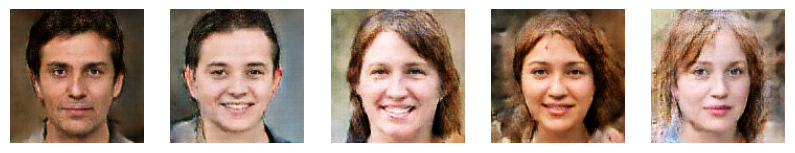

Epoch : 67
 Time:25.16
Generator Loss: 2.931884527206421 Discriminator Loss: 0.1291748583316803


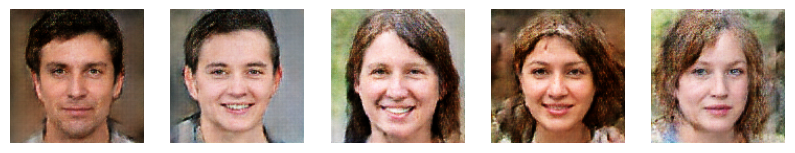

Epoch : 68
 Time:25.16
Generator Loss: 0.5474456548690796 Discriminator Loss: 1.8141369819641113


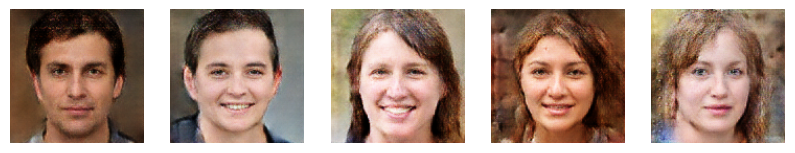

Epoch : 69
 Time:25.16
Generator Loss: 0.6539446115493774 Discriminator Loss: 1.1586817502975464


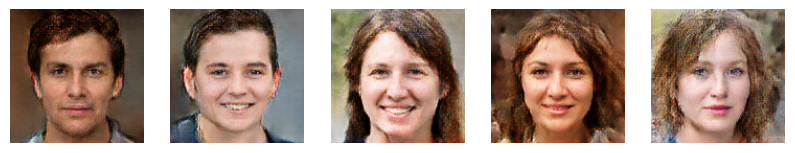

Epoch : 70
 Time:25.16
Generator Loss: 1.0689730644226074 Discriminator Loss: 0.8428685069084167


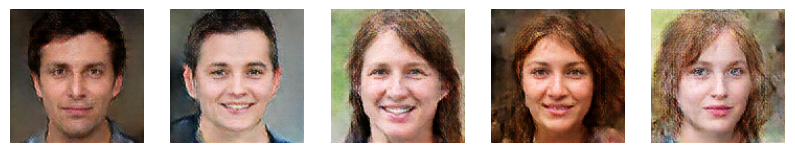

Epoch : 71
 Time:25.16
Generator Loss: 2.7274322509765625 Discriminator Loss: 0.24580727517604828


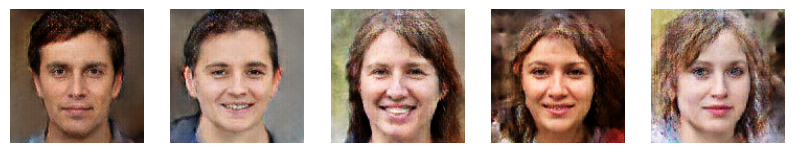

Epoch : 72
 Time:25.17
Generator Loss: 3.9015073776245117 Discriminator Loss: 0.20032820105552673


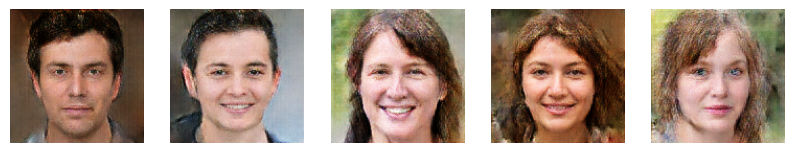

Epoch : 73
 Time:25.16
Generator Loss: 1.8010709285736084 Discriminator Loss: 0.3522524833679199


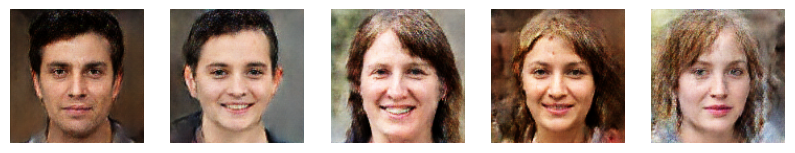

Epoch : 74
 Time:25.16
Generator Loss: 4.540112495422363 Discriminator Loss: 0.05871958285570145


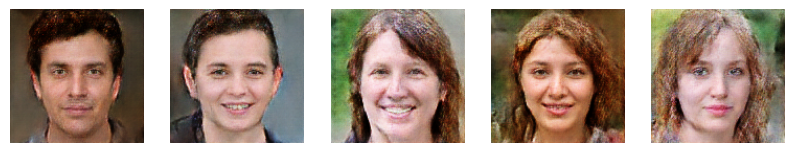

Epoch : 75
 Time:25.16
Generator Loss: 2.0966649055480957 Discriminator Loss: 0.22197675704956055


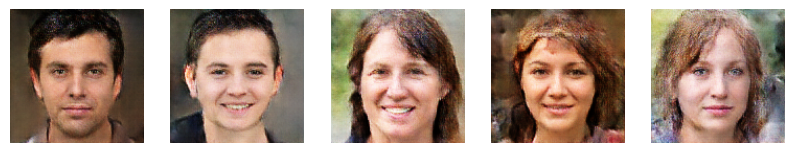

Epoch : 76
 Time:25.16
Generator Loss: 0.880232036113739 Discriminator Loss: 1.0000643730163574


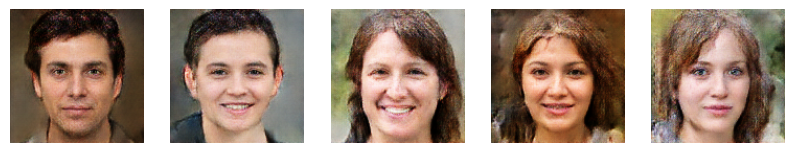

Epoch : 77
 Time:25.16
Generator Loss: 3.893775224685669 Discriminator Loss: 0.08781209588050842


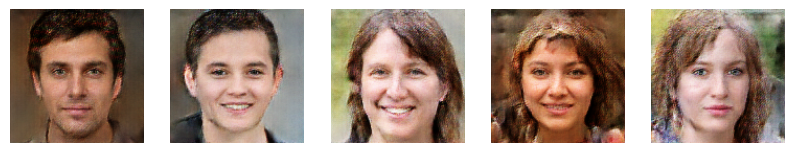

Epoch : 78
 Time:25.13
Generator Loss: 4.215851783752441 Discriminator Loss: 0.04976025968790054


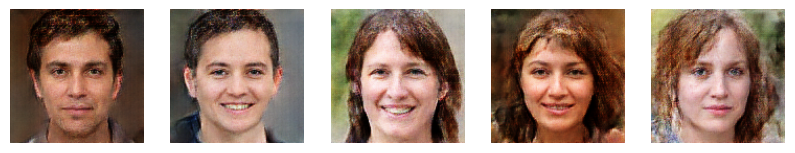

Epoch : 79
 Time:25.15
Generator Loss: 2.283766269683838 Discriminator Loss: 0.24635931849479675


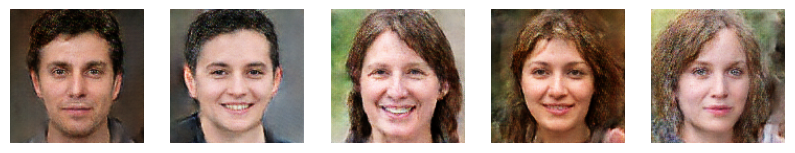

Epoch : 80
 Time:25.16
Generator Loss: 3.942464828491211 Discriminator Loss: 0.084607794880867


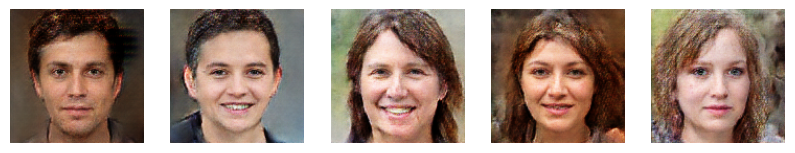

Epoch : 81
 Time:25.15
Generator Loss: 1.742268681526184 Discriminator Loss: 0.40813738107681274


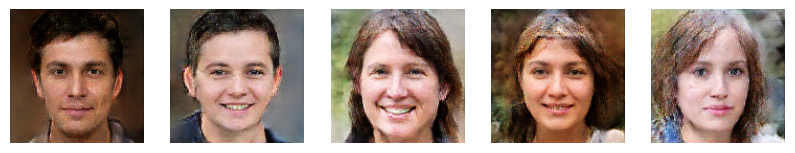

Epoch : 82
 Time:25.15
Generator Loss: 2.272395133972168 Discriminator Loss: 0.24080662429332733


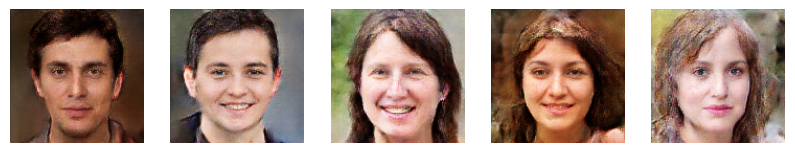

Epoch : 83
 Time:25.18
Generator Loss: 1.653167486190796 Discriminator Loss: 0.36983370780944824


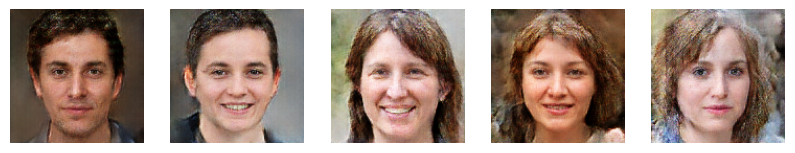

Epoch : 84
 Time:25.17
Generator Loss: 4.072410583496094 Discriminator Loss: 0.06847606599330902


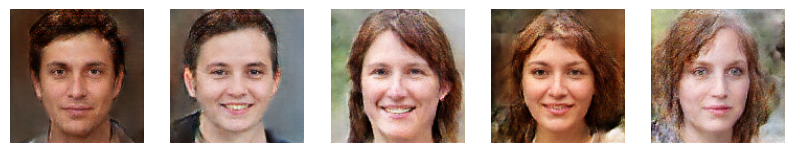

Epoch : 85
 Time:25.16
Generator Loss: 1.7194340229034424 Discriminator Loss: 0.39716172218322754


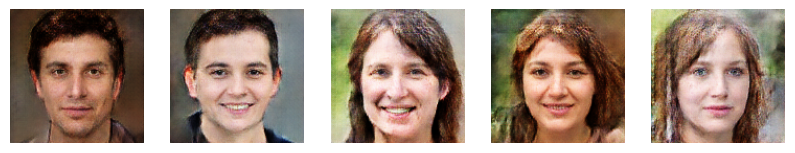

Epoch : 86
 Time:25.14
Generator Loss: 1.5853526592254639 Discriminator Loss: 0.36603912711143494


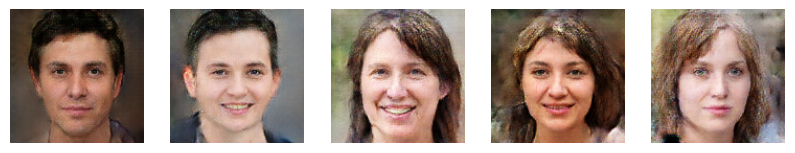

Epoch : 87
 Time:25.14
Generator Loss: 4.656444549560547 Discriminator Loss: 0.070336252450943


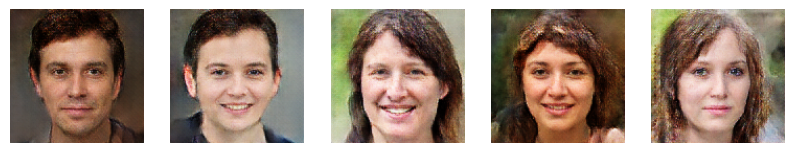

Epoch : 88
 Time:25.16
Generator Loss: 1.116512656211853 Discriminator Loss: 1.2160488367080688


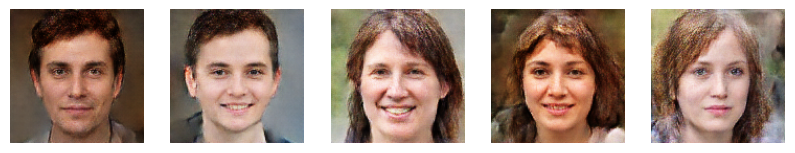

Epoch : 89
 Time:25.14
Generator Loss: 2.311779260635376 Discriminator Loss: 0.3184316158294678


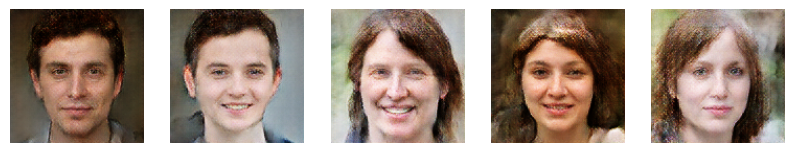

Epoch : 90
 Time:25.12
Generator Loss: 6.4244232177734375 Discriminator Loss: 0.8638543486595154


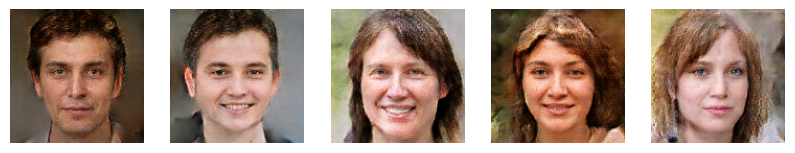

Epoch : 91
 Time:25.12
Generator Loss: 1.765346646308899 Discriminator Loss: 0.511785626411438


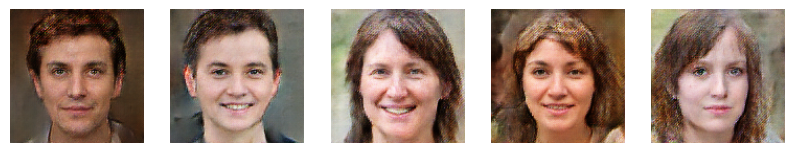

Epoch : 92
 Time:25.13
Generator Loss: 2.1580352783203125 Discriminator Loss: 0.28361544013023376


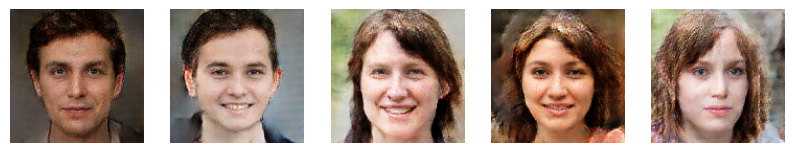

Epoch : 93
 Time:25.15
Generator Loss: 1.783340573310852 Discriminator Loss: 0.4098828434944153


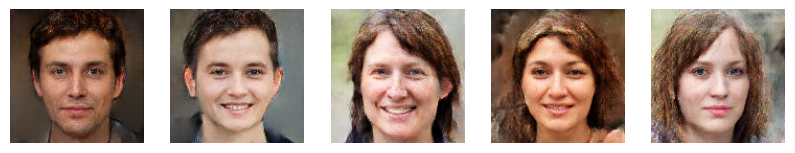

Epoch : 94
 Time:25.15
Generator Loss: 5.306215286254883 Discriminator Loss: 0.03685332089662552


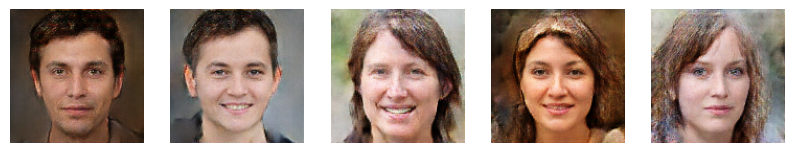

Epoch : 95
 Time:25.16
Generator Loss: 2.7190065383911133 Discriminator Loss: 0.21965381503105164


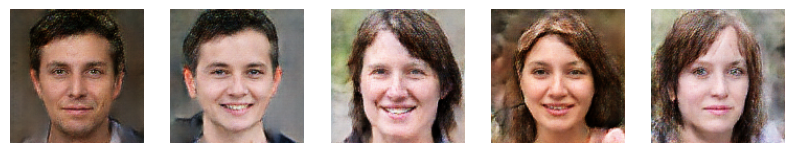

Epoch : 96
 Time:25.15
Generator Loss: 0.8854367733001709 Discriminator Loss: 0.965363621711731


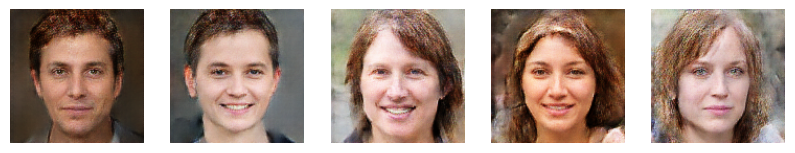

Epoch : 97
 Time:25.16
Generator Loss: 4.5485148429870605 Discriminator Loss: 0.05199793726205826


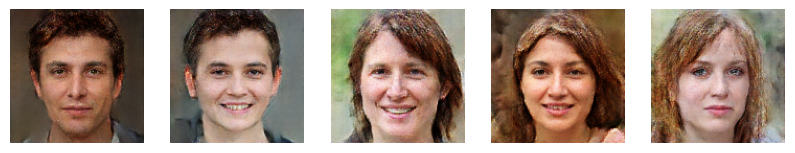

Epoch : 98
 Time:25.15
Generator Loss: 3.284860372543335 Discriminator Loss: 0.11532215029001236


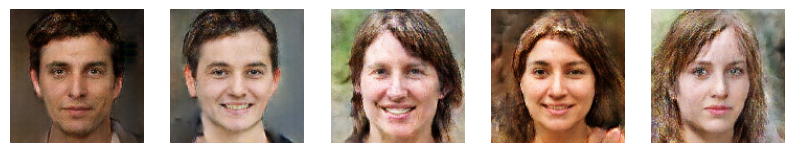

Epoch : 99
 Time:25.15
Generator Loss: 1.1521570682525635 Discriminator Loss: 0.9038613438606262


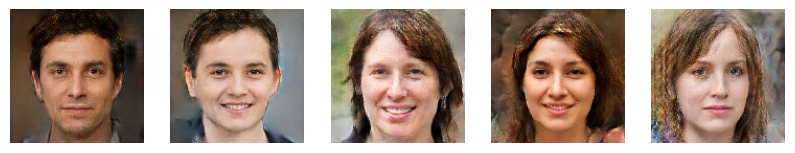

Epoch : 100
 Time:25.16
Generator Loss: 2.3674662113189697 Discriminator Loss: 0.2349202185869217


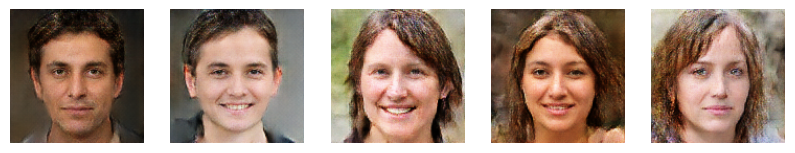

In [ ]:
import time

def train(epochs, dataset, generator, latent_dim):
    fixed_noise = tf.random.normal([25, latent_dim])  # Fixed noise for consistent image generation

    for epoch in range(epochs):
        print(f'Epoch : {epoch + 1}')
        start = time.time()

        for images in dataset:
            loss = train_steps(images)  # Assuming train_steps() is defined

        print(" Time:{}".format(np.round(time.time() - start, 2)))
        print("Generator Loss: {} Discriminator Loss: {}".format(loss['gen_loss'], loss['disc_loss']))

        # **Generate images after every 5 epochs**
        if (epoch + 1) % 1 == 0:
            generate_and_save_images(generator, epoch + 1, fixed_noise)  # Pass generator & fixed_noise

# Call the function properly
train(epochs=100, dataset=dataset, generator=generator, latent_dim=latent_dim)

## Training

# Some Generated Images


In [ ]:
generator.save('generator.h5')
discriminator.save("discriminator.h5")